### Imports

In [123]:
#import required modules
# = used package
import pandas as pd #
import numpy as np #
import pickle #
import matplotlib.pyplot as plt #
import seaborn as sns #
import patsy #
import statsmodels.api as sm #
import statsmodels.formula.api as smf #
import scipy.stats as stats #
from sklearn import model_selection #
from sklearn.linear_model import LinearRegression #
from sklearn.linear_model import Ridge, RidgeCV, Lasso, LassoCV # ridge and lasso
from sklearn import preprocessing, linear_model, pipeline #
from sklearn import feature_selection #
from sklearn import metrics #
from sklearn.preprocessing import scale #not necessary?
%matplotlib inline

### Prepare DataFrame

In [124]:
#open pickle file of cleaned and processed data
with open("players_iqr.pkl", 'rb') as picklefile: 
    df = pickle.load(picklefile)

In [125]:
#remove white space from column names for patsy
df.columns = df.columns.str.replace(' ','')
#rename columns with numbers in name for patsy
df = df.rename(columns={'1stServe':'FirstServe','1stServePointsWon':'FirstServePointsWon',
                        '1stServeReturnPointsWon':'FirstServeReturnPointsWon',
                        '2ndServePointsWon':'SecondServePointsWon',
                        '2ndServeReturnPointsWon':'SecondServeReturnPointsWon'})

In [126]:
df

,,FirstServe,FirstServePointsWon,FirstServeReturnPointsWon,SecondServePointsWon,SecondServeReturnPointsWon,Aces,BreakPointsConverted,BreakPointsFaced,BreakPointsOpportunities,BreakPointsSaved,...,ReturnPointsWon,ServiceGamesPlayed,ServiceGamesWon,TotalPointsWon,TotalServicePointsWon,Wins,Losses,Winnings,Ranking,log(Winnings)
Player,Year,,,,,,,,,,,,,,,,,,,,,
Pedro Sousa,2016,0.88,0.50,0.38,0.50,0.39,0,0.14,7,7,0.43,...,0.38,8,0.50,0.43,0.50,1,2,39820,119,10.592125
Roman Safiullin,2017,0.84,0.62,0.26,0.33,0.07,7,0.00,7,0,0.57,...,0.20,9,0.67,0.41,0.57,0,1,17334,381,9.760425
Pedro Sousa,2017,0.83,0.60,0.28,0.53,0.44,2,0.38,10,8,0.40,...,0.34,17,0.65,0.45,0.59,4,1,109827,119,11.606662
Rogerio Dutra Silva,2010,0.83,0.64,0.34,0.59,0.33,2,0.33,5,6,0.40,...,0.34,15,0.80,0.49,0.63,0,0,9761,125,9.186150
Daniel Gimeno-Traver,2017,0.81,0.54,0.00,0.33,0.33,1,0.00,2,0,0.50,...,0.20,2,0.50,0.35,0.50,0,1,32879,272,10.400589
Andres Artunedo Martinavarro,2014,0.77,0.67,0.09,0.55,0.40,3,0.50,6,2,0.50,...,0.26,9,0.67,0.44,0.64,0,1,10434,495,9.252825
Eduardo Struvay,2014,0.76,0.65,0.31,0.36,0.41,1,0.29,6,7,0.33,...,0.35,9,0.56,0.45,0.58,0,1,24218,1107T,10.094851
Riccardo Bellotti,2017,0.76,0.55,0.35,0.39,0.41,0,0.50,9,8,0.33,...,0.37,14,0.57,0.45,0.51,0,1,61154,432,11.021151
Austin Krajicek,2017,0.76,0.78,0.16,0.57,0.49,9,0.25,3,4,0.33,...,0.30,16,0.88,0.50,0.73,0,1,52940,291,10.876914


### Prepare Features and Independent Variables (Outcomes)

In [127]:
## create lists of features and outcomes used in modeling.
features = list(df.columns)[0:18]
outcomes = list(df.columns)[18:21]
outcomes.append(list(df.columns)[22])
wins = outcomes[0]
losses = outcomes[1]
#first looking at winnings for modeling
winnings = outcomes[2]
log_winnings = outcomes[3]

In [128]:
#all features
features

['FirstServe',
 'FirstServePointsWon',
 'FirstServeReturnPointsWon',
 'SecondServePointsWon',
 'SecondServeReturnPointsWon',
 'Aces',
 'BreakPointsConverted',
 'BreakPointsFaced',
 'BreakPointsOpportunities',
 'BreakPointsSaved',
 'DoubleFaults',
 'ReturnGamesPlayed',
 'ReturnGamesWon',
 'ReturnPointsWon',
 'ServiceGamesPlayed',
 'ServiceGamesWon',
 'TotalPointsWon',
 'TotalServicePointsWon']

In [129]:
#all outcomes
outcomes

['Wins', 'Losses', 'Winnings', 'log(Winnings)']

### Correlations

In [130]:
#correlations of all features and outcomes with each other
df.corr()

,FirstServe,FirstServePointsWon,FirstServeReturnPointsWon,SecondServePointsWon,SecondServeReturnPointsWon,Aces,BreakPointsConverted,BreakPointsFaced,BreakPointsOpportunities,BreakPointsSaved,...,ReturnGamesWon,ReturnPointsWon,ServiceGamesPlayed,ServiceGamesWon,TotalPointsWon,TotalServicePointsWon,Wins,Losses,Winnings,log(Winnings)
FirstServe,1.000000,-0.070659,0.025488,0.101417,-0.001924,0.048149,-0.018877,0.057709,0.062345,0.087945,...,-0.010676,0.004189,0.071920,0.137473,0.148349,0.180996,0.064832,0.053736,0.057882,0.101384
FirstServePointsWon,-0.070659,1.000000,0.021729,0.320765,-0.004724,0.460323,-0.041538,0.301925,0.324853,0.405751,...,-0.010193,-0.002793,0.376460,0.817829,0.648753,0.860033,0.356702,0.330581,0.361121,0.384496
FirstServeReturnPointsWon,0.025488,0.021729,1.000000,0.072707,0.301265,0.140165,0.324057,0.295724,0.313338,0.048347,...,0.757435,0.834267,0.261206,0.091319,0.496682,0.052335,0.256029,0.243278,0.240808,0.274043
SecondServePointsWon,0.101417,0.320765,0.072707,1.000000,0.103584,0.266269,0.052755,0.258691,0.277782,0.340147,...,0.096622,0.095585,0.296809,0.650764,0.622673,0.713076,0.268979,0.250918,0.281215,0.330846
SecondServeReturnPointsWon,-0.001924,-0.004724,0.301265,0.103584,1.000000,0.095494,0.264413,0.234212,0.249583,0.073867,...,0.603755,0.727338,0.209521,0.096553,0.408975,0.055004,0.193093,0.185217,0.199401,0.238017
Aces,0.048149,0.460323,0.140165,0.266269,0.095494,1.000000,0.037188,0.757405,0.784934,0.282672,...,0.139987,0.138023,0.866138,0.440922,0.428679,0.472101,0.825301,0.768628,0.798404,0.647967
BreakPointsConverted,-0.018877,-0.041538,0.324057,0.052755,0.264413,0.037188,1.000000,0.096368,0.086502,-0.015956,...,0.561759,0.387170,0.083182,-0.025670,0.255050,-0.007254,0.076989,0.062297,0.075022,0.073210
BreakPointsFaced,0.057709,0.301925,0.295724,0.258691,0.234212,0.757405,0.096368,1.000000,0.973352,0.271783,...,0.335205,0.331043,0.971296,0.354012,0.463110,0.354005,0.883470,0.943309,0.876036,0.761406
BreakPointsOpportunities,0.062345,0.324853,0.313338,0.277782,0.249583,0.784934,0.086502,0.973352,1.000000,0.247996,...,0.358483,0.352783,0.978278,0.372271,0.491198,0.380716,0.923453,0.909295,0.900444,0.744614
BreakPointsSaved,0.087945,0.405751,0.048347,0.340147,0.073867,0.282672,-0.015956,0.271783,0.247996,1.000000,...,0.046127,0.054317,0.274677,0.518091,0.464380,0.476143,0.252053,0.246990,0.258271,0.309517


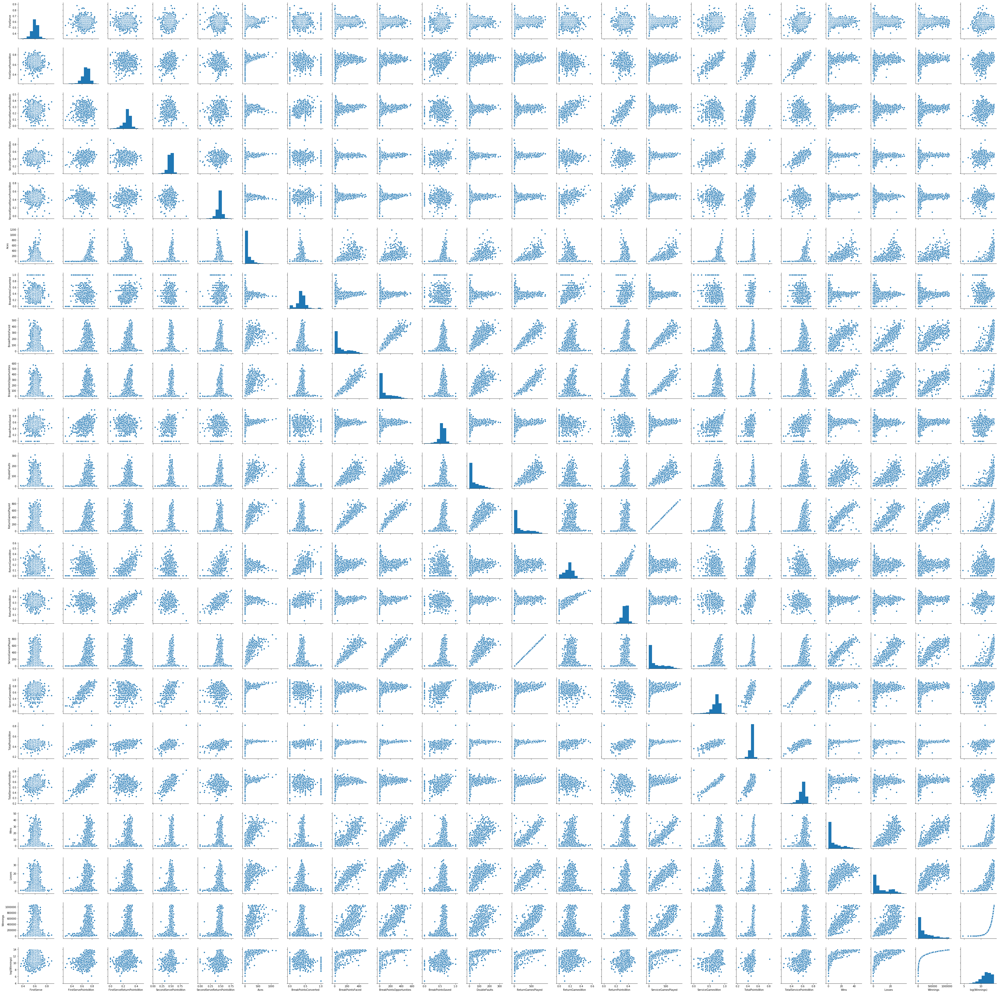

In [131]:
#pair plot to look at distributions of features and outcomes
colors = sns.hls_palette(2)
sns.pairplot(df)

## Modeling

### Model 1 - statsmodels(sm) all features, predicting winnings

In [132]:
#convert column names to string for patsy
str = ""
for feat in features:
    str+= feat + " + "
str

'FirstServe + FirstServePointsWon + FirstServeReturnPointsWon + SecondServePointsWon + SecondServeReturnPointsWon + Aces + BreakPointsConverted + BreakPointsFaced + BreakPointsOpportunities + BreakPointsSaved + DoubleFaults + ReturnGamesPlayed + ReturnGamesWon + ReturnPointsWon + ServiceGamesPlayed + ServiceGamesWon + TotalPointsWon + TotalServicePointsWon + '

In [133]:
#create design matrix with intercept using patsy
y,X = patsy.dmatrices('Winnings ~ FirstServe + FirstServePointsWon + FirstServeReturnPointsWon\
+ SecondServePointsWon + SecondServeReturnPointsWon + Aces + BreakPointsConverted + BreakPointsFaced\
+ BreakPointsOpportunities + BreakPointsSaved + DoubleFaults + ReturnGamesPlayed + ReturnGamesWon\
+ ReturnPointsWon + ServiceGamesPlayed + ServiceGamesWon + TotalPointsWon + TotalServicePointsWon',data=df,return_type='dataframe')

In [134]:
#split the data into training and testing groups
X_train,X_test,y_train,y_test = model_selection.train_test_split(X,y,test_size = 0.3)

In [135]:
#run first regression model with statsmodels on all data
model_1=sm.OLS(y_train,X_train)
fit_1 = model_1.fit()
fit_1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               Winnings   R-squared:                       0.847
Model:                            OLS   Adj. R-squared:                  0.844
Method:                 Least Squares   F-statistic:                     363.6
Date:                Fri, 27 Apr 2018   Prob (F-statistic):               0.00
Time:                        06:55:20   Log-Likelihood:                -15575.
No. Observations:                1204   AIC:                         3.119e+04
Df Residuals:                    1185   BIC:                         3.128e+04
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
==============================================================================================
                                 coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------
Intercept                   3957.4945   9.87e+04      0.040      0.968    -1.9e+05    1.98e+05
FirstServe                  7.556e+04   1.04e+05      0.724      0.469   -1.29e+05     2.8e+05
FirstServePointsWon         2.015e+05   2.79e+05      0.721      0.471   -3.46e+05    7.49e+05
FirstServeReturnPointsWon  -8.398e+04   1.54e+05     -0.545      0.586   -3.86e+05    2.18e+05
SecondServePointsWon        1.782e+05   1.92e+05      0.930      0.352   -1.98e+05    5.54e+05
SecondServeReturnPointsWon  1.157e+04   1.04e+05      0.111      0.912   -1.93e+05    2.16e+05
Aces                          26.8747     71.492      0.376      0.707    -113.391     167.140
BreakPointsConverted       -3487.9373   2.27e+04     -0.154      0.878   -4.81e+04    4.11e+04
BreakPointsFaced            -746.9654    166.937     -4.475      0.000   -1074.491    -419.440
BreakPointsOpportunities     500.3228    156.511      3.197      0.001     193.253     807.393
BreakPointsSaved            3.348e+04   3.16e+04      1.061      0.289   -2.85e+04    9.54e+04
DoubleFaults                 599.2095    149.981      3.995      0.000     304.951     893.468
ReturnGamesPlayed           -293.8387    785.820     -0.374      0.709   -1835.593    1247.915
ReturnGamesWon              1.029e+05   9.73e+04      1.057      0.291    -8.8e+04    2.94e+05
ReturnPointsWon             1.317e+05   3.18e+05      0.414      0.679   -4.93e+05    7.56e+05
ServiceGamesPlayed          1289.8534    776.037      1.662      0.097    -232.707    2812.414
ServiceGamesWon             4.448e+04   9.64e+04      0.461      0.645   -1.45e+05    2.34e+05
TotalPointsWon             -3.667e+05   5.45e+05     -0.673      0.501   -1.44e+06    7.02e+05
TotalServicePointsWon       -2.62e+05   5.03e+05     -0.521      0.602   -1.25e+06    7.24e+05
==============================================================================
Omnibus:                      373.131   Durbin-Watson:                   2.035
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            12465.841
Skew:                          -0.760   Prob(JB):                         0.00
Kurtosis:                      18.690   Cond. No.                     1.12e+05
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.12e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Text(0.5,1,'Residuals of Train Data')

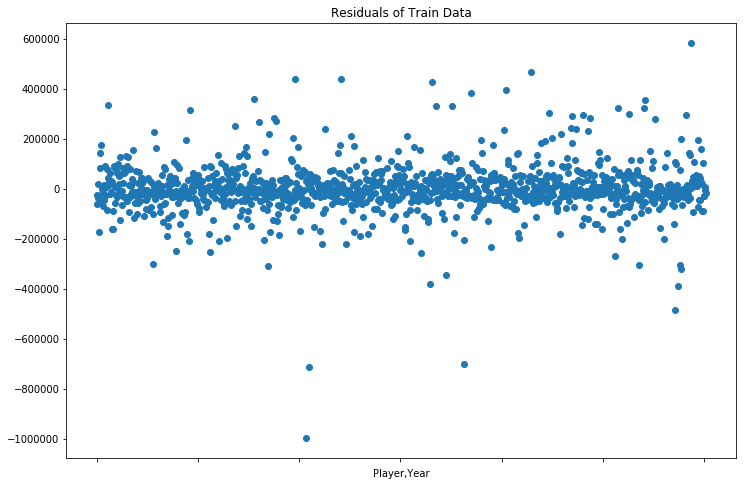

In [136]:
#residual plot on training data
fit_1.resid.plot(style='o',figsize=(12,8))
plt.title('Residuals of Train Data')

In [137]:
#predict of test data
pred_1 = fit_1.predict(X_test)

In [138]:
#find residuals on test data
resid_1 = np.array(y_test['Winnings']) - pred_1

((array([-3.00228364, -2.72122172, -2.56324599, -2.4512628 , -2.36353861,
         -2.29093656, -2.22871572, -2.17408744, -2.12526734, -2.08104208,
         -2.04054778, -2.00314675, -1.96835433, -1.93579327, -1.90516391,
         -1.87622412, -1.84877538, -1.82265278, -1.7977178 , -1.77385292,
         -1.75095754, -1.72894484, -1.70773939, -1.68727517, -1.66749411,
         -1.64834479, -1.62978152, -1.61176345, -1.59425395, -1.57722001,
         -1.5606318 , -1.54446223, -1.52868667, -1.51328264, -1.49822954,
         -1.48350848, -1.46910206, -1.45499426, -1.44117024, -1.42761627,
         -1.41431962, -1.40126842, -1.38845163, -1.37585895, -1.36348074,
         -1.35130799, -1.33933224, -1.32754556, -1.31594048, -1.30450996,
         -1.2932474 , -1.28214653, -1.27120145, -1.26040656, -1.24975659,
         -1.23924651, -1.22887157, -1.21862724, -1.20850923, -1.19851345,
         -1.188636  , -1.17887318, -1.16922145, -1.15967743, -1.15023789,
         -1.14089974, -1.13166003, -1.

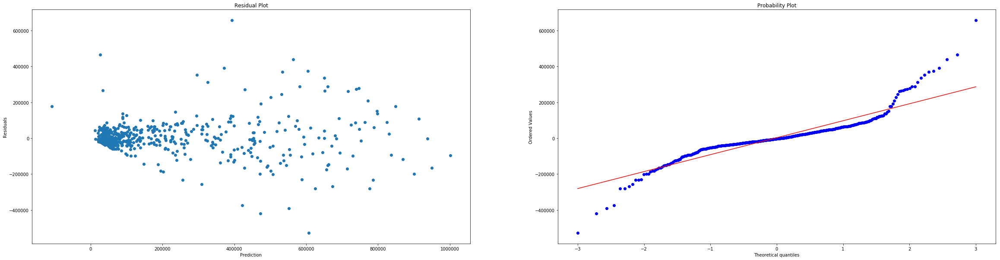

In [139]:
#Testing plots of residuals and probability plot
plt.figure(figsize=(40,10))
plt.xlim(1,22000000)
plt.subplot(1,2,1)
plt.scatter(pred_1,resid_1)
plt.title('Residual Plot')
plt.xlabel('Prediction')
plt.ylabel('Residuals')

plt.subplot(1,2,2)
stats.probplot(resid_1,dist='norm',plot=plt)

### Model 2 - statsmodels (smf) all features, predicting winnings

In [140]:
#look at all features and set winning to predicted variable
X = df.loc[:,features]
y = df.loc[:,winnings]

In [141]:
X_train,X_test,y_train,y_test = model_selection.train_test_split(X,y,test_size = 0.3)
Xy_train = X_train.copy()
Xy_train['Winnings'] = y_train

In [142]:
#stats model with no patsy
model_2 = smf.ols('Winnings ~ FirstServe + FirstServePointsWon + FirstServeReturnPointsWon\
+ SecondServePointsWon + SecondServeReturnPointsWon + Aces + BreakPointsConverted + BreakPointsFaced\
+ BreakPointsOpportunities + BreakPointsSaved + DoubleFaults + ReturnGamesPlayed + ReturnGamesWon\
+ ReturnPointsWon + ServiceGamesPlayed + ServiceGamesWon + TotalPointsWon + TotalServicePointsWon',data=Xy_train)
fit_2 = model_2.fit()
fit_2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               Winnings   R-squared:                       0.852
Model:                            OLS   Adj. R-squared:                  0.850
Method:                 Least Squares   F-statistic:                     379.9
Date:                Fri, 27 Apr 2018   Prob (F-statistic):               0.00
Time:                        06:55:21   Log-Likelihood:                -15516.
No. Observations:                1204   AIC:                         3.107e+04
Df Residuals:                    1185   BIC:                         3.117e+04
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
==============================================================================================
                                 coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------
Intercept                   1.975e+04   8.16e+04      0.242      0.809    -1.4e+05     1.8e+05
FirstServe                  3.532e+04   1.03e+05      0.342      0.732   -1.67e+05    2.38e+05
FirstServePointsWon         1.797e+05   2.64e+05      0.682      0.496   -3.37e+05    6.97e+05
FirstServeReturnPointsWon   6.912e+04   1.61e+05      0.430      0.667   -2.46e+05    3.84e+05
SecondServePointsWon        1.359e+05   1.83e+05      0.743      0.457   -2.23e+05    4.95e+05
SecondServeReturnPointsWon  5.093e+04   1.05e+05      0.487      0.626   -1.54e+05    2.56e+05
Aces                        -122.8404     68.747     -1.787      0.074    -257.720      12.039
BreakPointsConverted       -1849.5071   2.18e+04     -0.085      0.933   -4.47e+04     4.1e+04
BreakPointsFaced            -871.3431    162.764     -5.353      0.000   -1190.681    -552.005
BreakPointsOpportunities     588.2190    146.294      4.021      0.000     301.194     875.244
BreakPointsSaved            4.985e+04    3.1e+04      1.606      0.109   -1.11e+04    1.11e+05
DoubleFaults                 454.6556    138.334      3.287      0.001     183.248     726.063
ReturnGamesPlayed            232.7153    747.662      0.311      0.756   -1234.174    1699.604
ReturnGamesWon              8.456e+04   8.93e+04      0.947      0.344   -9.07e+04     2.6e+05
ReturnPointsWon            -1.434e+05   2.78e+05     -0.516      0.606   -6.89e+05    4.02e+05
ServiceGamesPlayed           893.7728    747.419      1.196      0.232    -572.639    2360.184
ServiceGamesWon            -1.966e+04   7.36e+04     -0.267      0.789   -1.64e+05    1.25e+05
TotalPointsWon             -2.379e+05   3.03e+05     -0.785      0.432   -8.32e+05    3.57e+05
TotalServicePointsWon      -1.664e+05   4.77e+05     -0.349      0.727    -1.1e+06    7.69e+05
==============================================================================
Omnibus:                      242.685   Durbin-Watson:                   2.091
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             4286.896
Skew:                           0.408   Prob(JB):                         0.00
Kurtosis:                      12.208   Cond. No.                     1.03e+05
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.03e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Text(0.5,1,'Residuals of Train Data')

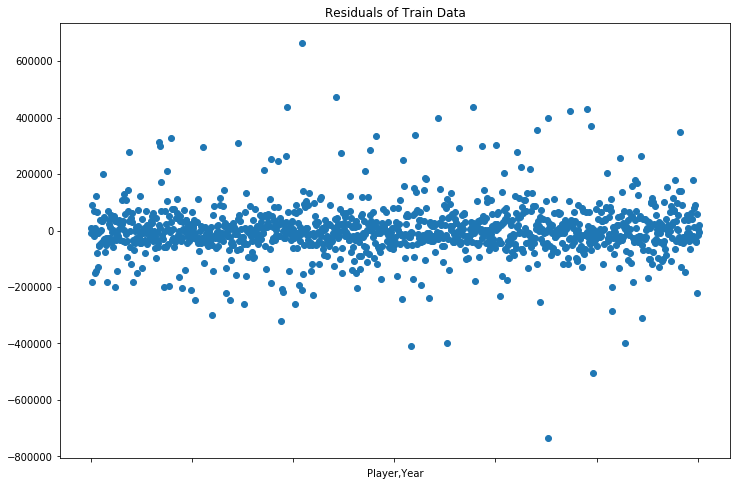

In [143]:
#training residuals
fit_2.resid.plot(style='o',figsize=(12,8))
plt.title('Residuals of Train Data')

In [144]:
#predictions and residuals on test data
pred_2 = fit_2.predict(X_test)
resid_2 = np.array(y_test) - pred_2

((array([-3.00228364, -2.72122172, -2.56324599, -2.4512628 , -2.36353861,
         -2.29093656, -2.22871572, -2.17408744, -2.12526734, -2.08104208,
         -2.04054778, -2.00314675, -1.96835433, -1.93579327, -1.90516391,
         -1.87622412, -1.84877538, -1.82265278, -1.7977178 , -1.77385292,
         -1.75095754, -1.72894484, -1.70773939, -1.68727517, -1.66749411,
         -1.64834479, -1.62978152, -1.61176345, -1.59425395, -1.57722001,
         -1.5606318 , -1.54446223, -1.52868667, -1.51328264, -1.49822954,
         -1.48350848, -1.46910206, -1.45499426, -1.44117024, -1.42761627,
         -1.41431962, -1.40126842, -1.38845163, -1.37585895, -1.36348074,
         -1.35130799, -1.33933224, -1.32754556, -1.31594048, -1.30450996,
         -1.2932474 , -1.28214653, -1.27120145, -1.26040656, -1.24975659,
         -1.23924651, -1.22887157, -1.21862724, -1.20850923, -1.19851345,
         -1.188636  , -1.17887318, -1.16922145, -1.15967743, -1.15023789,
         -1.14089974, -1.13166003, -1.

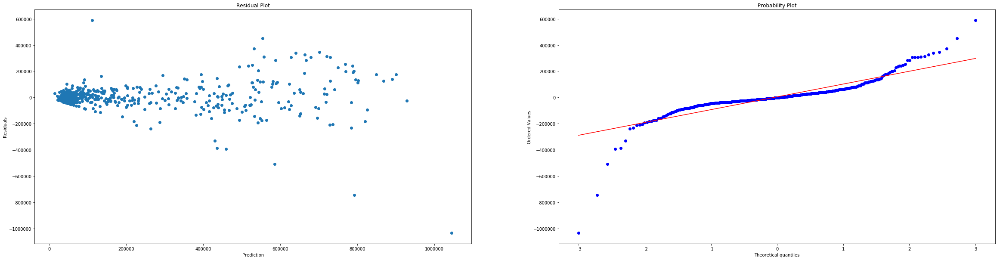

In [145]:
#Testing plots of residuals and probability plot
plt.figure(figsize=(40,10))
plt.xlim(1,22000000)
plt.subplot(1,2,1)
plt.scatter(pred_2,resid_2)
plt.title('Residual Plot')
plt.xlabel('Prediction')
plt.ylabel('Residuals')

plt.subplot(1,2,2)
stats.probplot(resid_2,dist='norm',plot=plt)

### Model 3 - sklearn all features, predicting winnings

In [146]:
#done earleir for SMF model
X = df.loc[:,features]
y = df.loc[:,winnings]

In [147]:
#done earlier for smf model
#split the data into training and testing groups
X_train,X_test,y_train,y_test = model_selection.train_test_split(X,y,test_size = 0.3)

In [148]:
lr1 = LinearRegression()
lr1.fit(X_train,y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)

In [149]:
lr1.score(X_train,y_train)

0.8481584776416141

In [150]:
lr1.score(X_test,y_test)

0.8244976789443214

In [151]:
predict_3 = lr1.predict(X_test)

Text(0,0.5,'Residuals')

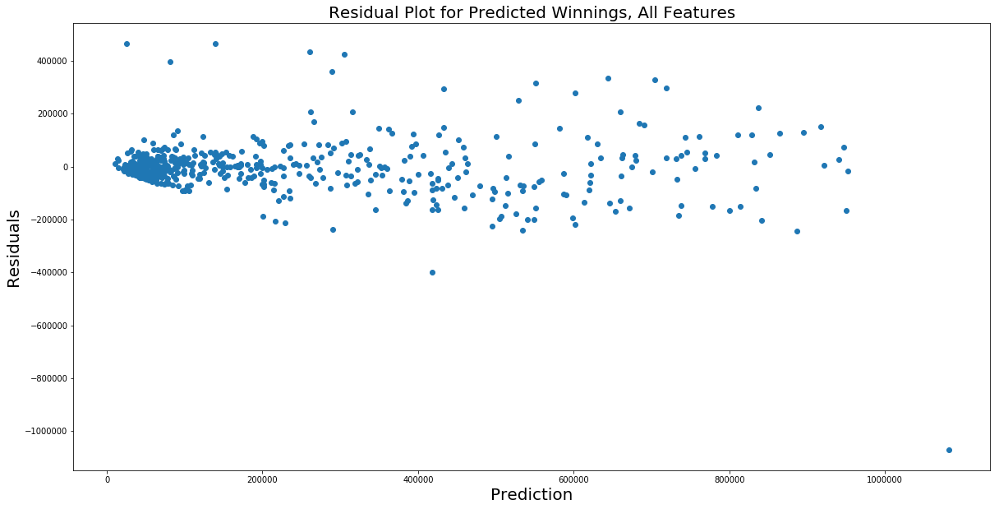

In [152]:
#Testing plots of residuals and probability plot
plt.figure(figsize=(20,10))
res = y_test - predict_3
plt.scatter(predict_3,res)
plt.title('Residual Plot for Predicted Winnings, All Features',fontsize=20)
plt.xlabel('Prediction',fontsize=20)
plt.ylabel('Residuals',fontsize=20)

((array([-3.00228364, -2.72122172, -2.56324599, -2.4512628 , -2.36353861,
         -2.29093656, -2.22871572, -2.17408744, -2.12526734, -2.08104208,
         -2.04054778, -2.00314675, -1.96835433, -1.93579327, -1.90516391,
         -1.87622412, -1.84877538, -1.82265278, -1.7977178 , -1.77385292,
         -1.75095754, -1.72894484, -1.70773939, -1.68727517, -1.66749411,
         -1.64834479, -1.62978152, -1.61176345, -1.59425395, -1.57722001,
         -1.5606318 , -1.54446223, -1.52868667, -1.51328264, -1.49822954,
         -1.48350848, -1.46910206, -1.45499426, -1.44117024, -1.42761627,
         -1.41431962, -1.40126842, -1.38845163, -1.37585895, -1.36348074,
         -1.35130799, -1.33933224, -1.32754556, -1.31594048, -1.30450996,
         -1.2932474 , -1.28214653, -1.27120145, -1.26040656, -1.24975659,
         -1.23924651, -1.22887157, -1.21862724, -1.20850923, -1.19851345,
         -1.188636  , -1.17887318, -1.16922145, -1.15967743, -1.15023789,
         -1.14089974, -1.13166003, -1.

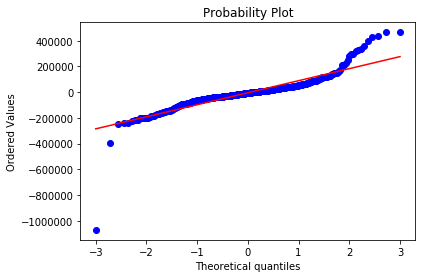

In [153]:
stats.probplot(res,dist='norm',plot=plt)

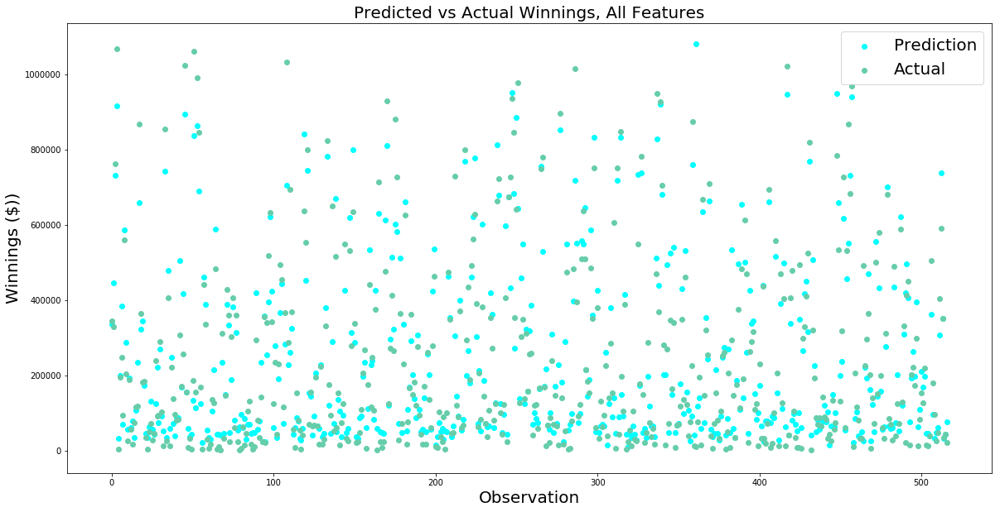

In [154]:
index = [i for i in range(len(predict_3))]
plt.figure(figsize=(20,10))
plt.rcParams['figure.dpi'] = 400
plt.scatter(index,predict_3,label='Prediction',c='#00FFFF')
plt.scatter(index,y_test,label='Actual',c='#66CDAA')
plt.title('Predicted vs Actual Winnings, All Features',fontsize = 20)
plt.xlabel('Observation',fontsize = 20)
plt.ylabel('Winnings ($))',fontsize = 20)
plt.legend(fontsize = 20)

In [155]:
#plot residuals vs features
plt.figure(figsize=(30,40))
for i,feat in enumerate(features):
    plt.subplot(6,3,i+1)
    plt.scatter(X_test[feat],res)
    plt.title(f'Residual vs {feat} Plot')
    plt.xlabel(f'{feat}')
    plt.ylabel('Residuals')

### Model 4 - sklearn all features, log winnings

In [156]:
#try log(winnings) since residuals are not normally distributed

In [157]:
#set X to all features and y to log_winnings
X = df.loc[:,features]
y = df.loc[:,log_winnings]

In [158]:
#split into training and testing data
X_train,X_test,y_train,y_test = model_selection.train_test_split(X,y,test_size = 0.3)

In [159]:
#create model and fit to training data
lr2 = LinearRegression()
lr2.fit(X_train,y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)

In [160]:
#score on training data
lr2.score(X_train,y_train)

0.6478133927205856

In [161]:
#score on testing data
lr2.score(X_test,y_test)

0.6286458040779536

In [162]:
#predict on train
log_predict_4_train = lr2.predict(X_train)
predict_4_train = np.exp(log_predict_4_train)

In [163]:
#predict on test data
log_predict_4 = lr2.predict(X_test)
predict_4 = np.exp(log_predict_4)

In [164]:
metrics.r2_score(y_train,predict_4_train)

-73799120622.57938

In [165]:
#R^2 train calc by hand
r_2_train = 1-np.sum((predict_4_train-y_train)**2)/np.sum((y_train-np.mean(y_train))**2)
r_2_train

-73799120622.57938

In [166]:
#R^2 test calculated by hand
r_2_test = 1-np.sum((predict_4-y_test)**2)/np.sum((y_test-np.mean(y_test))**2)
r_2_test

-65534523514.05355

((array([-3.00228364, -2.72122172, -2.56324599, -2.4512628 , -2.36353861,
         -2.29093656, -2.22871572, -2.17408744, -2.12526734, -2.08104208,
         -2.04054778, -2.00314675, -1.96835433, -1.93579327, -1.90516391,
         -1.87622412, -1.84877538, -1.82265278, -1.7977178 , -1.77385292,
         -1.75095754, -1.72894484, -1.70773939, -1.68727517, -1.66749411,
         -1.64834479, -1.62978152, -1.61176345, -1.59425395, -1.57722001,
         -1.5606318 , -1.54446223, -1.52868667, -1.51328264, -1.49822954,
         -1.48350848, -1.46910206, -1.45499426, -1.44117024, -1.42761627,
         -1.41431962, -1.40126842, -1.38845163, -1.37585895, -1.36348074,
         -1.35130799, -1.33933224, -1.32754556, -1.31594048, -1.30450996,
         -1.2932474 , -1.28214653, -1.27120145, -1.26040656, -1.24975659,
         -1.23924651, -1.22887157, -1.21862724, -1.20850923, -1.19851345,
         -1.188636  , -1.17887318, -1.16922145, -1.15967743, -1.15023789,
         -1.14089974, -1.13166003, -1.

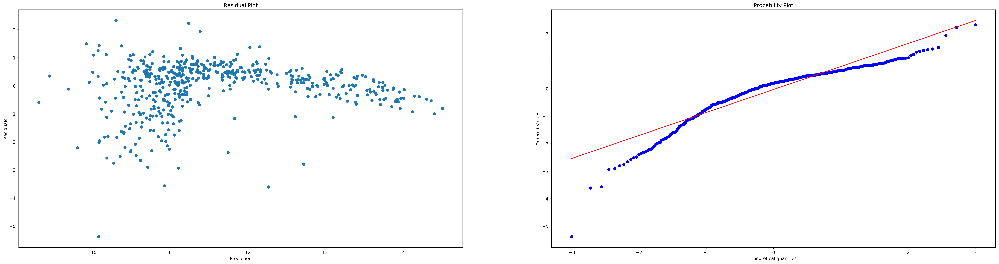

In [167]:
#Testing plots of residuals and probability plot
plt.figure(figsize=(40,10))
plt.subplot(1,2,1)
res = y_test - log_predict_4
plt.scatter(log_predict_4,res)
plt.title('Residual Plot')
plt.xlabel('Prediction')
plt.ylabel('Residuals')

plt.subplot(1,2,2)
stats.probplot(res,dist='norm',plot=plt)

In [168]:
#log(winnings) look much better, residuals more normally distributed. but R^2 is troublesome

### Model 5 - sklearn selected features, predicting winnings

In [169]:
selected_features = ['FirstServe',
 'FirstServePointsWon',
 'FirstServeReturnPointsWon',
 'SecondServePointsWon',
 'SecondServeReturnPointsWon',
 'Aces',
 'BreakPointsConverted',
 'BreakPointsFaced',
 'BreakPointsOpportunities',
 'BreakPointsSaved',
 'DoubleFaults',
 'ReturnGamesWon',
 'ReturnPointsWon',
 'ServiceGamesWon',
 'TotalServicePointsWon']

In [170]:
X = df.loc[:,selected_features]
y = df.loc[:,winnings]

In [171]:
#split into training and testing data
X_train,X_test,y_train,y_test = model_selection.train_test_split(X,y,test_size = 0.3)

In [172]:
#create model and fit to training data
lr4 = LinearRegression()
lr4.fit(X_train,y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)

In [173]:
#score on training data
lr4.score(X_train,y_train)

0.822328727049315

In [174]:
#score on testing data
lr4.score(X_test,y_test)

0.8589138420350105

In [175]:
#predict on train
predict_6_train = lr4.predict(X_train)

In [176]:
#predict on test data
predict_6 = lr4.predict(X_test)

In [177]:
#R^2 train calc by hand -- validating the score
r_2_train = 1-np.sum((predict_6_train-y_train)**2)/np.sum((y_train-np.mean(y_train))**2)
r_2_train

0.822328727049315

In [178]:
#R^2 test calculated by hand -- validating the score
r_2_test = 1-np.sum((predict_6-y_test)**2)/np.sum((y_test-np.mean(y_test))**2)
r_2_test

0.8589138420350105

Text(0,0.5,'Residuals')

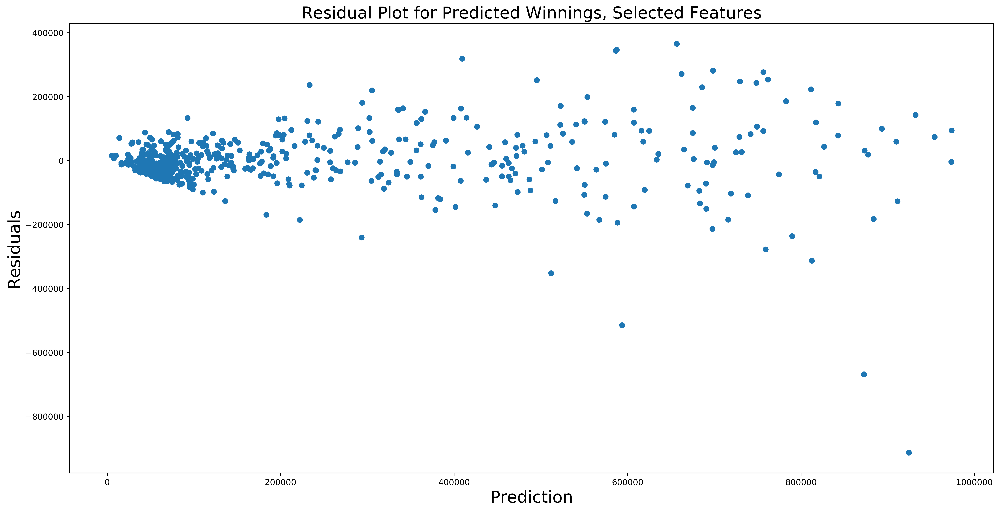

In [179]:
#Testing plots of residuals and probability plot
plt.figure(figsize=(20,10))
res = y_test - predict_6
plt.scatter(predict_6,res)
plt.title('Residual Plot for Predicted Winnings, Selected Features',fontsize=20)
plt.xlabel('Prediction',fontsize=20)
plt.ylabel('Residuals',fontsize=20)

((array([-3.00228364, -2.72122172, -2.56324599, -2.4512628 , -2.36353861,
         -2.29093656, -2.22871572, -2.17408744, -2.12526734, -2.08104208,
         -2.04054778, -2.00314675, -1.96835433, -1.93579327, -1.90516391,
         -1.87622412, -1.84877538, -1.82265278, -1.7977178 , -1.77385292,
         -1.75095754, -1.72894484, -1.70773939, -1.68727517, -1.66749411,
         -1.64834479, -1.62978152, -1.61176345, -1.59425395, -1.57722001,
         -1.5606318 , -1.54446223, -1.52868667, -1.51328264, -1.49822954,
         -1.48350848, -1.46910206, -1.45499426, -1.44117024, -1.42761627,
         -1.41431962, -1.40126842, -1.38845163, -1.37585895, -1.36348074,
         -1.35130799, -1.33933224, -1.32754556, -1.31594048, -1.30450996,
         -1.2932474 , -1.28214653, -1.27120145, -1.26040656, -1.24975659,
         -1.23924651, -1.22887157, -1.21862724, -1.20850923, -1.19851345,
         -1.188636  , -1.17887318, -1.16922145, -1.15967743, -1.15023789,
         -1.14089974, -1.13166003, -1.

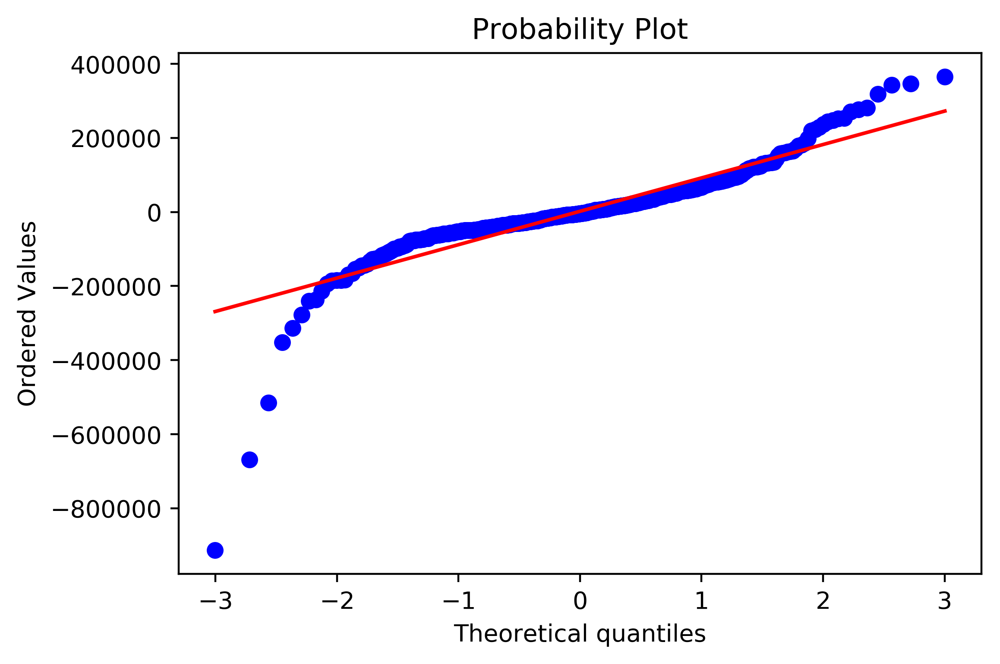

In [180]:
stats.probplot(res,dist='norm',plot=plt)

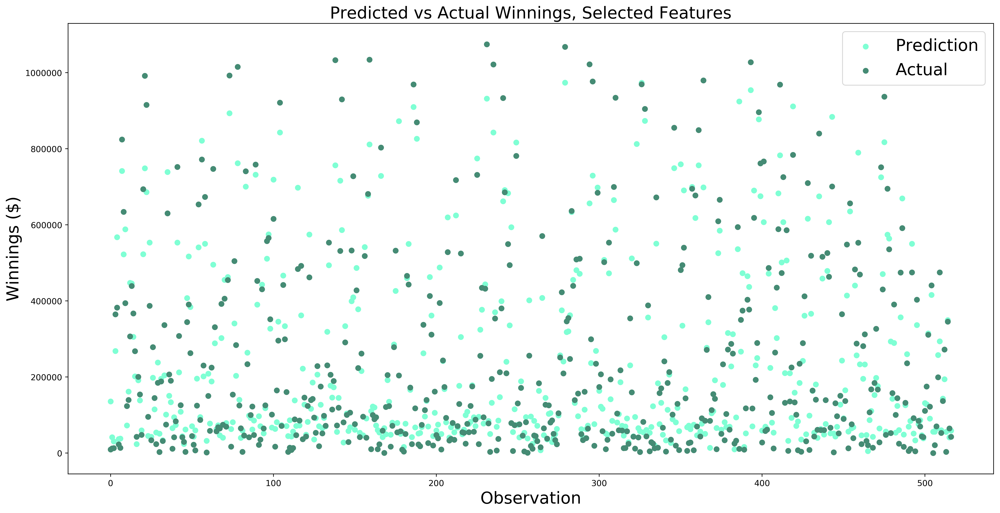

In [181]:
index = [i for i in range(len(predict_6))]
plt.figure(figsize=(20,10))
plt.rcParams['figure.dpi'] = 400
plt.scatter(index,predict_6,label='Prediction',c='#7FFFD4')
plt.scatter(index,y_test,label='Actual',c='#458B74')
plt.title('Predicted vs Actual Winnings, Selected Features',fontsize = 20)
plt.xlabel('Observation',fontsize = 20)
plt.ylabel('Winnings ($)',fontsize = 20)
plt.legend(fontsize = 20)

In [182]:
#plot residuals vs features
plt.figure(figsize=(30,40))
for i,feat in enumerate(selected_features):
    plt.subplot(6,3,i+1)
    plt.scatter(X_test[feat],res)
    plt.title(f'Residual vs {feat} Plot')
    plt.xlabel(f'{feat}')
    plt.ylabel('Residuals')

In [183]:
#just look at selected features with log(winnings)

### Model 6 - sklearn selected features, log(winnings)

In [184]:
X = df.loc[:,selected_features]
y = df.loc[:,log_winnings]

In [185]:
#split into training and testing data
X_train,X_test,y_train,y_test = model_selection.train_test_split(X,y,test_size = 0.3)

In [186]:
#create model and fit to training data
lr3 = LinearRegression()
lr3.fit(X_train,y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)

In [187]:
#score on training data
lr3.score(X_train,y_train)

0.6508361808716008

In [188]:
#score on testing data
lr3.score(X_test,y_test)

0.5996043932313755

In [189]:
#predict on train
log_predict_5_train = lr3.predict(X_train)
predict_5_train = np.exp(log_predict_5_train)

In [190]:
#predict on test data
log_predict_5 = lr3.predict(X_test)
predict_5 = np.exp(log_predict_5)

In [191]:
#R^2 train calc by hand -- this looks funky
r_2_train = 1-np.sum((predict_5_train-y_train)**2)/np.sum((y_train-np.mean(y_train))**2)
r_2_train

-75825897827.25693

In [192]:
#R^2 test calculated by hand -- this looks funky
r_2_test = 1-np.sum((predict_5-y_test)**2)/np.sum((y_test-np.mean(y_test))**2)
r_2_test

-87039698172.16884

((array([-3.00228364, -2.72122172, -2.56324599, -2.4512628 , -2.36353861,
         -2.29093656, -2.22871572, -2.17408744, -2.12526734, -2.08104208,
         -2.04054778, -2.00314675, -1.96835433, -1.93579327, -1.90516391,
         -1.87622412, -1.84877538, -1.82265278, -1.7977178 , -1.77385292,
         -1.75095754, -1.72894484, -1.70773939, -1.68727517, -1.66749411,
         -1.64834479, -1.62978152, -1.61176345, -1.59425395, -1.57722001,
         -1.5606318 , -1.54446223, -1.52868667, -1.51328264, -1.49822954,
         -1.48350848, -1.46910206, -1.45499426, -1.44117024, -1.42761627,
         -1.41431962, -1.40126842, -1.38845163, -1.37585895, -1.36348074,
         -1.35130799, -1.33933224, -1.32754556, -1.31594048, -1.30450996,
         -1.2932474 , -1.28214653, -1.27120145, -1.26040656, -1.24975659,
         -1.23924651, -1.22887157, -1.21862724, -1.20850923, -1.19851345,
         -1.188636  , -1.17887318, -1.16922145, -1.15967743, -1.15023789,
         -1.14089974, -1.13166003, -1.

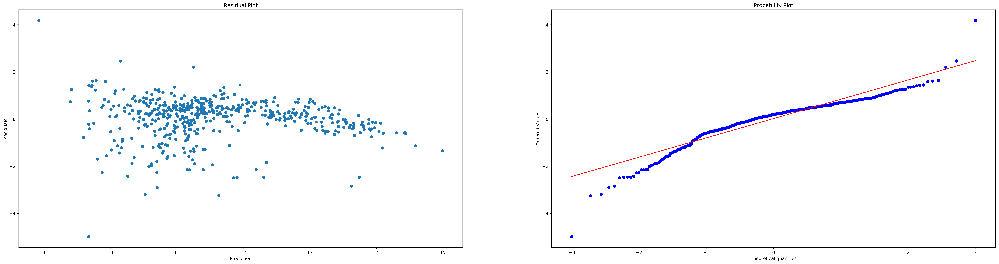

In [193]:
#Testing plots of residuals and probability plot
plt.figure(figsize=(40,10))
plt.subplot(1,2,1)
res = y_test - log_predict_5
plt.scatter(log_predict_5,res)
plt.title('Residual Plot')
plt.xlabel('Prediction')
plt.ylabel('Residuals')

plt.subplot(1,2,2)
stats.probplot(res,dist='norm',plot=plt)

### Model 7 - sklearn selected features, predicting winnings, k=10 folds cross validation

In [194]:
selected_features = ['FirstServe',
 'FirstServePointsWon',
 'FirstServeReturnPointsWon',
 'SecondServePointsWon',
 'SecondServeReturnPointsWon',
 'Aces',
 'BreakPointsConverted',
 'BreakPointsFaced',
 'BreakPointsOpportunities',
 'BreakPointsSaved',
 'DoubleFaults',
 'ReturnGamesWon',
 'ReturnPointsWon',
 'ServiceGamesWon',
 'TotalServicePointsWon']

In [195]:
X = df.loc[:,selected_features]
y = df.loc[:,winnings]

In [196]:
#set up k folds CV with k=10
k_folds = model_selection.KFold(n_splits=10,shuffle=True)

In [197]:
#10-fold cross validation with scores
lr7 = LinearRegression()
scores = model_selection.cross_val_score(lr7,X,y,cv=k_folds,scoring='r2')
print(scores)

[0.78923326 0.85489581 0.91398972 0.7975627  0.77342437 0.82926499
 0.80976111 0.80965798 0.85927232 0.87024995]


In [198]:
#average score from k=10 folds
np.mean(scores)

0.8307312212786464

In [199]:
#predict on k-folds
predict_7 = model_selection.cross_val_predict(lr7,X,y,cv=k_folds)

In [200]:
resid_7 = predict_7-y

Text(0,0.5,'Residuals')

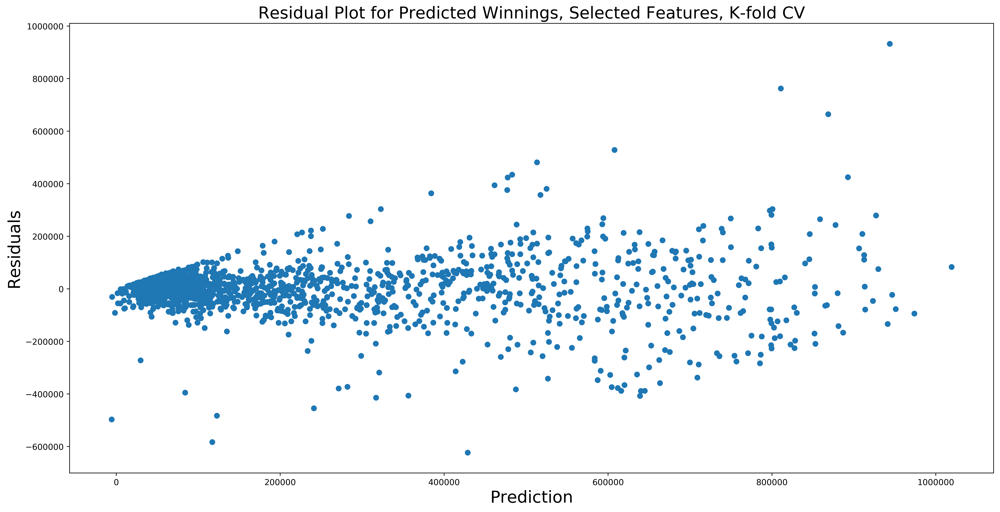

In [201]:
#Testing plots of residuals and probability plot
plt.figure(figsize=(20,10))
plt.scatter(predict_7,resid_7)
plt.title('Residual Plot for Predicted Winnings, Selected Features, K-fold CV',fontsize=20)
plt.xlabel('Prediction',fontsize=20)
plt.ylabel('Residuals',fontsize=20)

((array([-3.35094788, -3.0970083 , -2.95598598, ...,  2.95598598,
          3.0970083 ,  3.35094788]),
  array([-622802.89524029, -582978.22578428, -496806.21212511, ...,
          664628.3493209 ,  762879.57132762,  932756.91489326])),
 (95641.40406105405, -50.833338187558844, 0.9202999503495028))

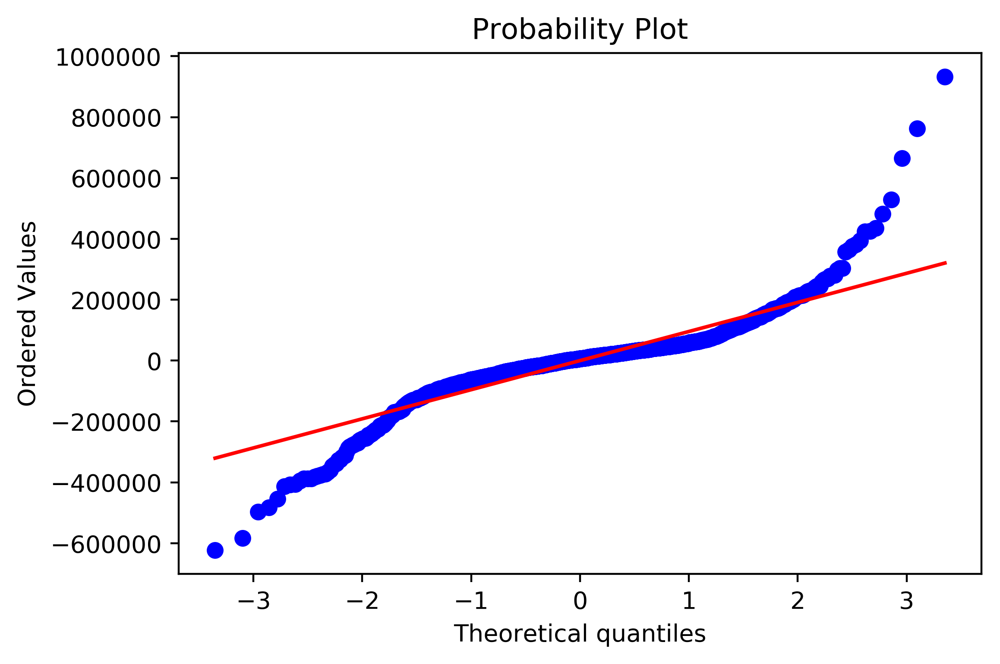

In [202]:
stats.probplot(resid_7,dist='norm',plot=plt)

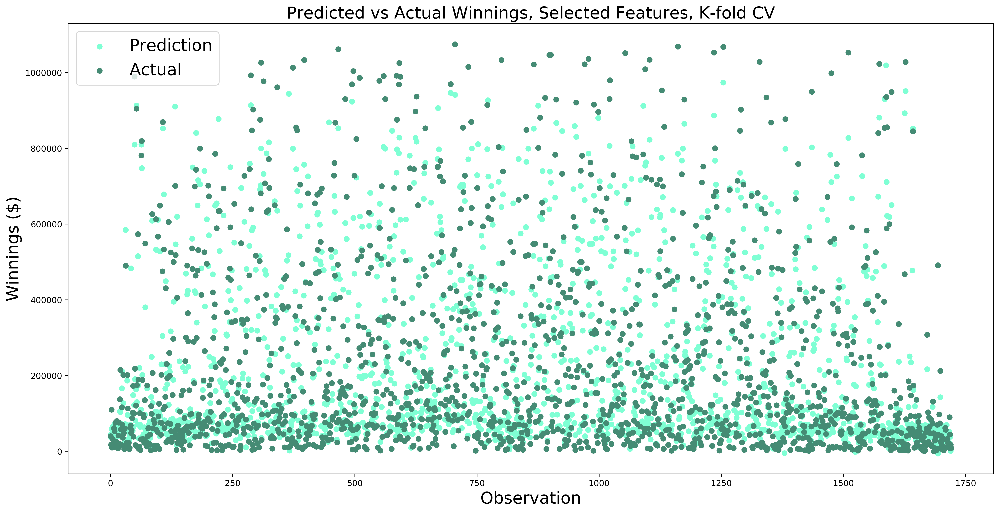

In [203]:
index = [i for i in range(len(predict_7))]
plt.figure(figsize=(20,10))
plt.rcParams['figure.dpi'] = 400
plt.scatter(index,predict_7,label='Prediction',c='#7FFFD4')
plt.scatter(index,y,label='Actual',c='#458B74')
plt.title('Predicted vs Actual Winnings, Selected Features, K-fold CV',fontsize = 20)
plt.xlabel('Observation',fontsize = 20)
plt.ylabel('Winnings ($)',fontsize = 20)
plt.legend(fontsize = 20)

In [204]:
#plot residuals vs features
plt.figure(figsize=(30,40))
for i,feat in enumerate(selected_features):
    plt.subplot(6,3,i+1)
    plt.scatter(X_test[feat],res)
    plt.title(f'Residual vs {feat} Plot')
    plt.xlabel(f'{feat}')
    plt.ylabel('Residuals')

## Regularization

### Ridge Regularization

In [205]:
#split into training and testing data
X_train,X_test,y_train,y_test = model_selection.train_test_split(X,y,test_size = 0.3)

[ 52847.75193471  83858.32244848  51791.75076315  83525.02553773
  36794.89540068    283.91572093  -3395.37595337    392.89818979
    415.58659645  26550.98470969    740.4102515   70248.56656834
  75081.6169657   54323.46508044 130409.43922856]
[ 59899.5195045   24842.42521524 -51683.49663585  60724.8114749
  14451.12758604    363.0472451   -3283.08372066    471.86560641
    732.35870598  -9065.29490912    636.36227995  54387.9431706
 -17486.55510067  31157.33232739  60274.18122149]
[ 47027.93639391  24234.53874675 -73739.13579766  48805.76997065
  13261.58222926    365.12092223  12143.72575263    195.25708877
   1205.72933688  -3860.53860081    343.64074783  13257.08971916
 -56598.6089753   46556.23372776 -24359.59321433]
[ 5.68833021e+04  5.70936451e+04 -7.11477703e+04  6.85044105e+04
  1.55628871e+04  3.51200480e+02  2.02885250e+04  6.02925760e+00
  1.42717969e+03  3.11297965e+03  3.17176978e+02 -1.13675802e+04
 -6.58206926e+04  5.61945805e+04 -1.16513529e+05]


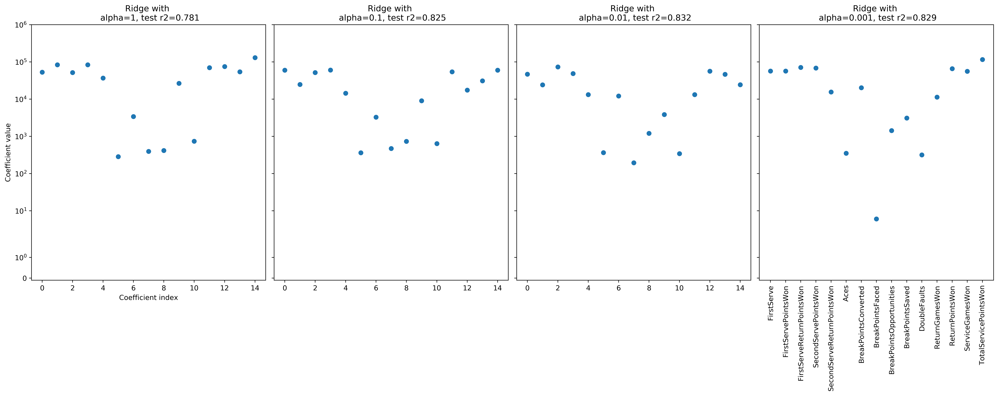

In [206]:
#Peform multiple Ridges to find the best alpha
k_folds = model_selection.KFold(n_splits=10,shuffle=True)
#alphas = np.logspace(-5,1, num=4)
alphas = [1,0.1,0.01,0.001]
fig, axes = plt.subplots(1,len(alphas), figsize=(20, 8), sharey=True)
for i, alpha in enumerate(alphas):
   ax = axes.flat[i]
   est = linear_model.Ridge(alpha=alpha, normalize=True)
   cv_result = model_selection.cross_validate(
       est, X=X, y=y, cv=k_folds, return_train_score=True)
   est.fit(X_train, y_train)
   print(est.coef_)
   coefs = np.abs(est.coef_)
   r2 = np.mean(cv_result["test_score"])
   ax.scatter(np.arange(len(coefs)), coefs)
   plt.xticks(np.arange(len(coefs)), X.columns, rotation=90)
   ax.set_title(f"Ridge with \n alpha={round(alpha,3)}, test r2={round(r2,3)}")
   
ax = axes.flat[0]
ax.set_yscale("symlog")
ax.set_ylim((-.1, 1e6))
ax.set_ylabel("Coefficient value")
ax.set_xlabel("Coefficient index")

plt.tight_layout()

### Lasso Regularization

[ 3.69444973e+04  2.37754975e+03 -7.49108550e+04  3.01445685e+04
  1.08160690e+04  3.49523464e+02  2.01001666e+04 -9.11411680e+00
  1.44814280e+03  3.73466443e+03  3.08910285e+02 -1.27329475e+04
 -5.72371290e+04  5.21564930e+04 -1.71426534e+04]
[ 5.81913946e+04  6.13006358e+04 -7.10419368e+04  7.10057153e+04
  1.54963192e+04  3.48644404e+02  2.14994155e+04 -2.44348240e+01
  1.46141524e+03  4.25631755e+03  3.15843587e+02 -1.51860529e+04
 -6.61086252e+04  5.74939697e+04 -1.28799271e+05]
[ 6.03109581e+04  6.71782313e+04 -7.06546529e+04  7.50815713e+04
  1.59642982e+04  3.48556336e+02  2.16392025e+04 -2.59664555e+01
  1.46274212e+03  4.30852054e+03  3.16536949e+02 -1.54313647e+04
 -6.69957468e+04  5.80260455e+04 -1.39936843e+05]
[ 6.05228562e+04  6.77658235e+04 -7.06159201e+04  7.54890402e+04
  1.60110956e+04  3.48547527e+02  2.16531796e+04 -2.61196137e+01
  1.46287480e+03  4.31374127e+03  3.16606285e+02 -1.54558959e+04
 -6.70844586e+04  5.80792341e+04 -1.41050280e+05]


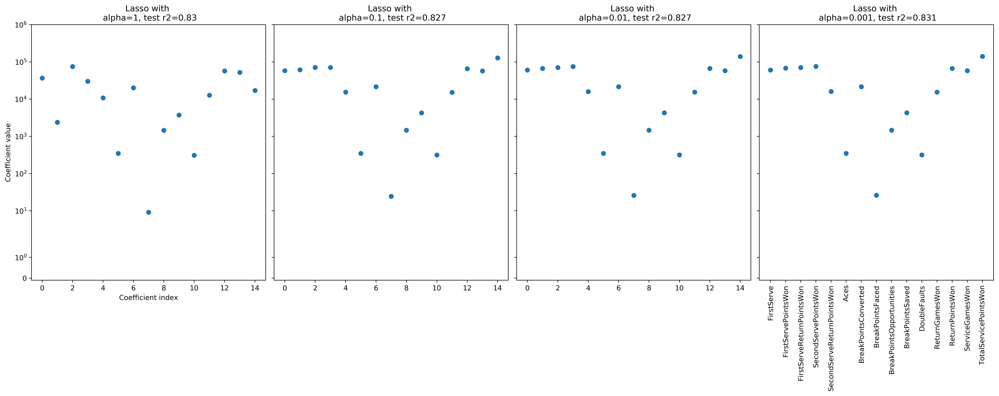

In [207]:
#Peform multiple Ridges to find the best alpha
k_folds = model_selection.KFold(n_splits=10,shuffle=True)
#alphas = np.logspace(-5,1, num=4)
alphas = [1,0.1,0.01,0.001]
fig, axes = plt.subplots(1,len(alphas), figsize=(20, 8), sharey=True)
for i, alpha in enumerate(alphas):
   ax = axes.flat[i]
   est = linear_model.Lasso(alpha=alpha, normalize=True)
   cv_result = model_selection.cross_validate(
       est, X=X, y=y, cv=k_folds, return_train_score=True)
   est.fit(X_train, y_train)
   print(est.coef_)
   coefs = np.abs(est.coef_)
   r2 = np.mean(cv_result["test_score"])
   ax.scatter(np.arange(len(coefs)), coefs)
   plt.xticks(np.arange(len(coefs)), X.columns, rotation=90)
   ax.set_title(f"Lasso with \n alpha={round(alpha,3)}, test r2={round(r2,3)}")
   
ax = axes.flat[0]
ax.set_yscale("symlog")
ax.set_ylim((-.1, 1e6))
ax.set_ylabel("Coefficient value")
ax.set_xlabel("Coefficient index")

plt.tight_layout()

### Elastic Net Regularization

[5.06868913e+02 2.00311009e+03 1.65933669e+03 1.70436764e+03
 9.88216579e+02 2.35486332e+00 1.87790502e+02 3.12165820e+00
 3.12283841e+00 8.31596668e+02 6.37446362e+00 1.29198264e+03
 2.04724633e+03 1.30998352e+03 2.82992683e+03]
[4.68101050e+03 1.81996747e+04 1.50588953e+04 1.54522084e+04
 8.93496488e+03 2.20727736e+01 1.64445252e+03 2.93065541e+01
 2.93369054e+01 7.53581162e+03 5.97543438e+01 1.17777895e+04
 1.85733873e+04 1.18789165e+04 2.57070669e+04]
[ 26601.83799651  87633.05083073  71094.66031978  73885.57129844
  41243.26228544    138.03017045   5232.15112744    185.54649543
    187.12889633  35224.5520663     373.00623274  58715.98590564
  87974.38407951  56394.90948159 124255.1482642 ]
[ 59103.61872613  66938.10005387  27089.31955855  78561.01018794
  29895.47755872    312.34997536  -5573.7936276     435.69473937
    478.12143377  16170.29574421    786.84794997  66084.34211291
  52791.66316435  45271.1474821  113136.04043805]


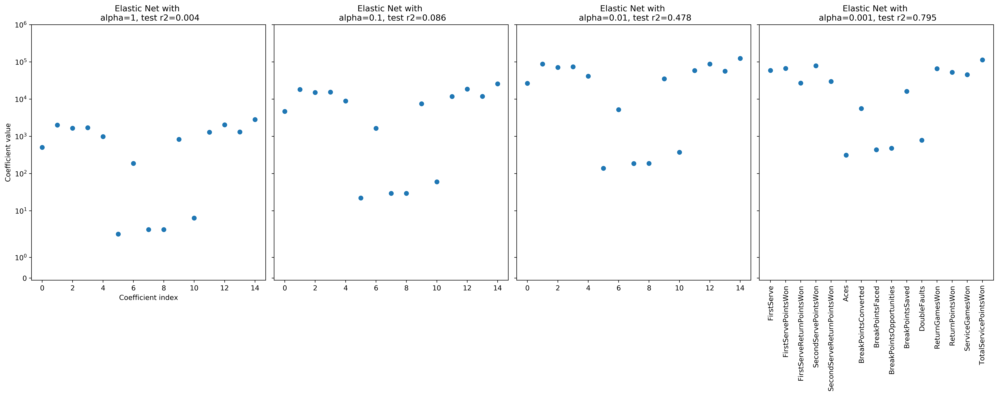

In [208]:
#Peform multiple Ridges to find the best alpha
k_folds = model_selection.KFold(n_splits=10,shuffle=True)
#alphas = np.logspace(-5,1, num=4)
alphas = [1,0.1,0.01,0.001]
fig, axes = plt.subplots(1,len(alphas), figsize=(20, 8), sharey=True)
for i, alpha in enumerate(alphas):
   ax = axes.flat[i]
   est = linear_model.ElasticNet(alpha=alpha, normalize=True)
   cv_result = model_selection.cross_validate(
       est, X=X, y=y, cv=k_folds, return_train_score=True)
   est.fit(X_train, y_train)
   print(est.coef_)
   coefs = np.abs(est.coef_)
   r2 = np.mean(cv_result["test_score"])
   ax.scatter(np.arange(len(coefs)), coefs)
   plt.xticks(np.arange(len(coefs)), X.columns, rotation=90)
   ax.set_title(f"Elastic Net with \n alpha={round(alpha,3)}, test r2={round(r2,3)}")
   
ax = axes.flat[0]
ax.set_yscale("symlog")
ax.set_ylim((-.1, 1e6))
ax.set_ylabel("Coefficient value")
ax.set_xlabel("Coefficient index")

plt.tight_layout()

### Pipeline, Selek K best with selected features

In [209]:
X = df.loc[:,selected_features]
y = df.loc[:,winnings]

In [210]:
select_pipe = pipeline.Pipeline(
    #preprocess data
    [("imp", preprocessing.Imputer()), 
     #scale features
     ("std", preprocessing.StandardScaler()),
     #select k best
     ("select",
      feature_selection.SelectKBest(
          score_func=feature_selection.f_regression)), 
     #use linear regression
     ("lin", LinearRegression())
    ])

In [211]:
select_pipe.fit(X,y)
select_pipe.score(X,y)

0.8349364423111957

In [212]:
feat_support = select_pipe.named_steps["select"].get_support()
feat = X.columns[feat_support]
coef = select_pipe.named_steps["lin"].coef_

list(zip(feat, coef))

[('FirstServePointsWon', -2347.8146662269824),
 ('SecondServePointsWon', 1216.3883249778387),
 ('Aces', 49076.32359988386),
 ('BreakPointsFaced', -12390.596057933479),
 ('BreakPointsOpportunities', 176398.56276931148),
 ('DoubleFaults', 25591.389533139965),
 ('ReturnGamesWon', 2744.580476695832),
 ('ReturnPointsWon', -6414.658000851353),
 ('ServiceGamesWon', 6932.134583806307),
 ('TotalServicePointsWon', 2264.401744006481)]

In [213]:
cv_result = model_selection.cross_validate(
        select_pipe, X=X, y=y, cv=10, return_train_score=True)
print(f"train: {np.mean(cv_result['train_score']):.3}, test: {np.mean(cv_result['test_score']):.3}")

train: 0.835, test: 0.828


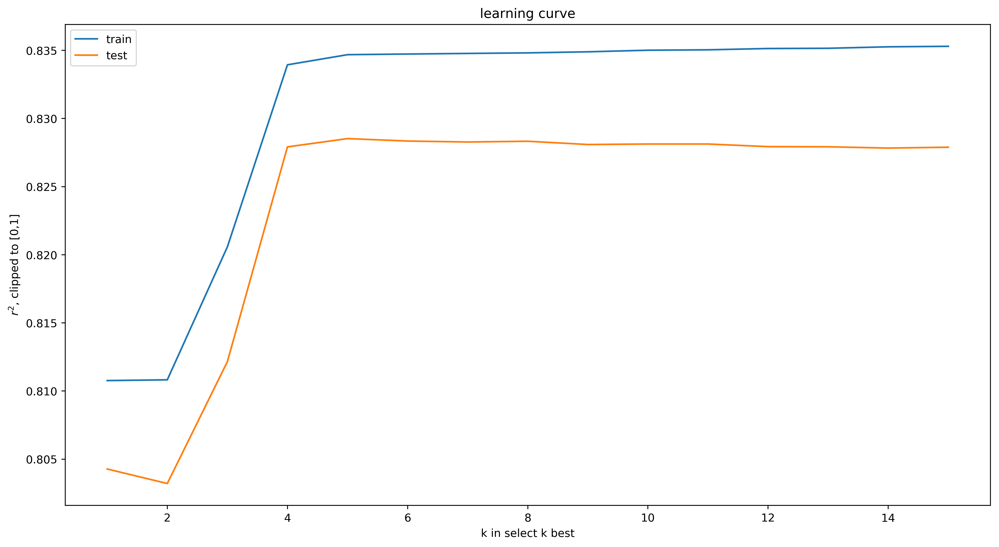

In [214]:
plt.figure(figsize=(15, 8))


train_scores = []
test_scores = []
# define feature range
num_feats = len(X.columns)
feat_range = np.arange(num_feats)+1
# for each k in feat_range
for num_f in feat_range:
    # set pipeline params
    select_pipe.set_params(select__k=num_f)
    # get cross val scores
    cv_result = model_selection.cross_validate(
        select_pipe, X=X, y=y, cv=10, return_train_score=True)
    train_scores.append(np.maximum(np.mean(cv_result['train_score']), 0))
    test_scores.append(np.maximum(np.mean(cv_result['test_score']), 0))

# plot test vs train
plt.plot(feat_range, train_scores, label="train")
plt.plot(feat_range, test_scores, label="test")

# find index of best score
best_i = np.argmax(test_scores)
# annotate score
# ann_xy = (feat_range[best_i], test_scores[best_i])
# ann_text = f"$r^2$={test_scores[best_i]:.2}, $k$={feat_range[best_i]}"
# annotate(ann_text, xy=ann_xy, xytext=(.6,.4), textcoords='axes fraction',
#             arrowprops=dict(arrowstyle="->"),
#             )

plt.xlabel("k in select k best")
plt.ylabel("$r^2$, clipped to [0,1]")
plt.title("learning curve")
plt.legend()

In [215]:
best_i

4

In [216]:
test_scores

[0.8042759733527471,
 0.8032104257207541,
 0.8121558282535434,
 0.8279179698323261,
 0.8285260403952664,
 0.828346742920424,
 0.8282769247118601,
 0.8283308741392501,
 0.828091618086862,
 0.8281283993978172,
 0.8281283882557148,
 0.8279363933712205,
 0.8279242568889458,
 0.8278305904460226,
 0.8278931494977199]